In [1]:
import Trader
import pandas as pd
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import gc
from datetime import datetime

In [9]:
self= Trader.Trader()
symbol= 'ETHUSD'
tf= 'M30'
bars_window= 200
n_std= 2

start_date= datetime(2019, 1, 30)
end_date= datetime.now()

df_data= self.get_ohlc_range(symbol, tf, start_date, end_date)

Updating balance and positions...
Ready to trade.


In [16]:
df_data['roll_close_mean']= df_data['close'].rolling(bars_window).mean()
df_data['roll_close_std']= df_data['close'].rolling(bars_window).std()

df_data['up_band']= df_data['roll_close_mean'] + n_std*df_data['roll_close_std']
df_data['down_band']= df_data['roll_close_mean'] - n_std*df_data['roll_close_std']

df_data.tail(3)

,time,open,high,low,close,tick_volume,spread,real_volume,roll_close_mean,roll_close_std,up_band,down_band
time,,,,,,,,,,,,
2026-01-19 23:30:00,2026-01-19 23:30:00,3211.77,3214.33,3207.88,3211.04,1193,200,0,3284.84055,42.941019,3370.722587,3198.958513
2026-01-20 00:00:00,2026-01-20 00:00:00,3209.29,3212.73,3186.37,3204.17,1975,200,0,3284.37200,43.307716,3370.987431,3197.756569
2026-01-20 00:30:00,2026-01-20 00:30:00,3204.12,3204.13,3181.35,3184.56,2102,200,0,3283.86200,43.878642,3371.619285,3196.104715


In [27]:
open_position = 0
trades = []
position_size = 100

dict_map= {j:i for i, j in enumerate(df_data.columns)}

In [12]:
for row in df_data.values:
    if open_position == 0 and row[dict_map['close']] < row[dict_map['down_band']]:
        open_position = 1
        trades+= [{'time': row[dict_map['time']], 'price': row[dict_map['close']], 'down_band': row[dict_map['down_band']], 'side': 'Long', 'position_size': position_size}]

    elif open_position == 1 and row[dict_map['close']] > row[dict_map['up_band']]:
        open_position = 0
        trades+= [{'time': row[dict_map['time']], 'price': row[dict_map['close']], 'up_band': row[dict_map['up_band']], 'side': 'Short', 'position_size': position_size}]

In [13]:
df_trades= pd.DataFrame(trades)

df_buy= df_trades[df_trades['side'] == 'Long']
df_sell= df_trades[df_trades['side'] == 'Short']

df_trades['return %'] = df_trades['price']/df_trades['price'].shift(1)
df_trades['return $'] = df_trades['position_size']*df_trades['return %'] - 100
df_trades.loc[df_trades['side'] == 1, ['return %', 'return $']] = 0


In [17]:
fig = go.Figure()

fig.add_trace(go.Candlestick(x= df_data.index, open= df_data['open'], high= df_data['high'], low= df_data['low'], close= df_data['close']))
fig.add_trace(go.Scatter(x= df_data.index, y= df_data['up_band']))
fig.add_trace(go.Scatter(x= df_data.index, y= df_data['down_band']))
fig.add_trace(go.Scatter(x=df_buy['time'], y= df_buy['price'], mode= 'markers', marker_color='#11dd11', marker_size=8))
fig.add_trace(go.Scatter(x=df_sell['time'], y=df_sell['price'], mode= 'markers', marker_color='#dd2222', marker_size=8 ))

fig.update_layout(height= 400, width= 1000, margin= dict(l=50, r=50, t=30, b=30), template='seaborn', xaxis_rangeslider_visible= False)
fig.show()

del fig
gc.collect()

1129

Result


In [ ]:
df_trades['return $'].cumsum().plot()
return_perc = (df_trades['return $'].sum()/position_size) * 100

print(f'this strategy had a return of {return_perc:.2f}%')

Function

In [21]:
self= Trader.Trader()

def boll_bands(symbol: str, bars_window: int, n_std: float, position_size: int, timeframe: str, start_date: str, end_date= datetime.now(), fig= None):
    
    start= pd.to_datetime(start_date).to_pydatetime()                                                                       #converts date used as parameter to datetime format. To be updated with timedelta
    end_date= datetime.now()

    df_data= self.get_ohlc_range(symbol, timeframe, start, end_date)                                                        #uses Trader to plot candlestick graph

    open_position = 0
    trades = []

    df_data['roll_close_mean']= df_data['close'].rolling(bars_window).mean()
    df_data['roll_close_std']= df_data['close'].rolling(bars_window).std()

    df_data['up_band']= df_data['roll_close_mean'] + (n_std)*df_data['roll_close_std']                                      #up band of boll band
    df_data['down_band']= df_data['roll_close_mean'] - (n_std)*df_data['roll_close_std']                                    #down band

    dict_map= {j:i for i, j in enumerate(df_data.columns)}                                                                  #dictrionary to be used in the for loop. Better efficiency than iterrows

    for row in df_data.values:
        if open_position == 0 and row[dict_map['close']] < row[dict_map['down_band']]:
            open_position = 1
            trades+= [{'time': row[dict_map['time']], 'price': row[dict_map['close']], 'up_band': row[dict_map['up_band']], 'down_band': row[dict_map['down_band']], 'side': 'Long', 'position_size': position_size}]

        elif open_position == 1 and row[dict_map['close']] > row[dict_map['up_band']]:
            open_position = 0
            trades+= [{'time': row[dict_map['time']], 'price': row[dict_map['close']], 'up_band': row[dict_map['up_band']], 'down_band': row[dict_map['down_band']], 'side': 'Short', 'position_size': position_size}]

    df_trades= pd.DataFrame(trades)                                                                                         #creates DataFrame with all trades made
    df_trades.set_index("time", inplace= True)                                                                              
    df_trades['return %'] = df_trades['price']/df_trades['price'].shift(1)
    df_trades['return $'] = df_trades['position_size']*df_trades['return %'] - position_size
    df_trades.loc[df_trades['side'] == 'Long', ['return %', 'return $']] = 0                                                #opening positions give no returns
    df_trades['return $'].cumsum().plot(label=f"bars={bars_window}, std={n_std}, tf={timeframe}")                           #graph of return over time

    return_perc = (df_trades['return $'].sum()/position_size) * 100
    n_trades= len(df_trades[df_trades['side'] == 'Short'])                                                                  #one trade is done only when an operation is closed
    print(f'Strategy (bars= {bars_window}, number of std= {n_std}, timeframe= {timeframe}, position size= {position_size}) had a return of {return_perc:.2f}%, with a number of {n_trades} trades')

    return df_trades, return_perc

Updating balance and positions...
Ready to trade.


Strategy (bars= 100, number of std= 2, timeframe= M15, position size= 100) had a return of 140.33%, with a number of 611 trades
Strategy (bars= 100, number of std= 2, timeframe= M30, position size= 100) had a return of 47.00%, with a number of 285 trades
Strategy (bars= 100, number of std= 3, timeframe= M15, position size= 100) had a return of 24.63%, with a number of 279 trades
Strategy (bars= 100, number of std= 3, timeframe= M30, position size= 100) had a return of 106.95%, with a number of 130 trades
Strategy (bars= 150, number of std= 2, timeframe= M15, position size= 100) had a return of 45.22%, with a number of 386 trades
Strategy (bars= 150, number of std= 2, timeframe= M30, position size= 100) had a return of 118.49%, with a number of 207 trades
Strategy (bars= 150, number of std= 3, timeframe= M15, position size= 100) had a return of 46.69%, with a number of 197 trades
Strategy (bars= 150, number of std= 3, timeframe= M30, position size= 100) had a return of 165.51%, with a n

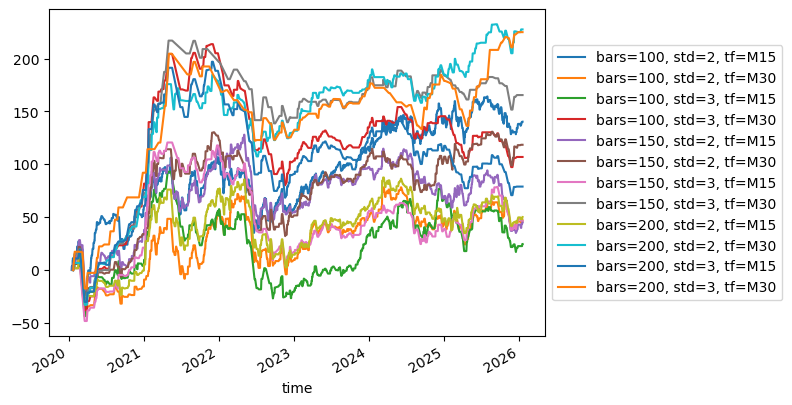

In [23]:
positive_return = 0
negative_return = 0
neutral_return = 0
cutoff = 50 


bars_windows = [100, 150, 200]
stds = [2, 3]
timeframes = ['M15', 'M30']

for bars in bars_windows:
    for std in stds:
        for tf in timeframes:
            df_trades, return_perc = boll_bands('ETHUSD', bars, std, 100, tf, '2020-01-13')

            if return_perc > cutoff:                                                                                         #counts how many operations were positive, negative or neutral depending on a arbitrary cutoff
                positive_return+= 1
            elif return_perc < (cutoff - 50):
                negative_return+= 1
            else:
                neutral_return+= 1

print(f"positives: {positive_return}, negatives: {negative_return}, neutral: {neutral_return}")

plt.legend(loc='center left', bbox_to_anchor=(1,0.5))                                                                        #no labels over the graph
plt.show()

In [ ]:
boll_bands('ETHUSD', 200, 2, 100, 'M30', '2025-01-30')

In [2]:
self= Trader.Trader()

def boll_bands(symbol: str, bars_window: int, n_std: float, timeframe: str, position_size: int, start_date: str, end_date= datetime.now(), fig= None):
    
    start= pd.to_datetime(start_date).to_pydatetime()                                                                       #converts date used as parameter to datetime format. To be updated with timedelta
    end_date= datetime.now()

    df_data= self.get_ohlc_range(symbol, timeframe, start, end_date)                                                        #uses Trader to plot candlestick graph

    open_position = 0
    trades = []

    df_data['roll_close_mean']= df_data['close'].rolling(bars_window).mean()
    df_data['roll_close_std']= df_data['close'].rolling(bars_window).std()

    df_data['up_band']= df_data['roll_close_mean'] + (n_std)*df_data['roll_close_std']                                      #up band of boll band
    df_data['down_band']= df_data['roll_close_mean'] - (n_std)*df_data['roll_close_std']                                    #down band

    dict_map= {j:i for i, j in enumerate(df_data.columns)}
    vals= df_data.values                                                                  #dictrionary to be used in the for loop. Better efficiency than iterrows

    for k in range(1, len(vals)):
        prev= vals[k-1]
        curr= vals[k]
        if open_position == 0 and prev[dict_map['close']] < prev[dict_map['down_band']]:
            open_position = 1
            trades+= [{
                'time': curr[dict_map['time']],
                'price': curr[dict_map['close']],
                'up_band': curr[dict_map['up_band']],
                'down_band': curr[dict_map['down_band']],
                'side': 'Long',
                'position_size': position_size
                }]

        elif open_position == 1 and prev[dict_map['close']] > prev[dict_map['up_band']]:
            open_position = 0
            trades+= [{
                'time': curr[dict_map['time']],
                'price': curr[dict_map['close']],
                'up_band': curr[dict_map['up_band']],
                'down_band': curr[dict_map['down_band']],
                'side': 'Short',
                'position_size': position_size
                }]

    df_trades= pd.DataFrame(trades)                                                                                         #creates DataFrame with all trades made
    df_trades.set_index("time", inplace= True)                                                                              
    df_trades['return %'] = df_trades['price']/df_trades['price'].shift(1)
    df_trades['return $'] = df_trades['position_size']*df_trades['return %'] - position_size
    df_trades.loc[df_trades['side'] == 'Long', ['return %', 'return $']] = 0                                                #opening positions give no returns
    df_trades['return $'].cumsum().plot(label=f"bars={bars_window}, std={n_std}, tf={timeframe}")                           #graph of return over time

    return_perc = (df_trades['return $'].sum()/position_size) * 100
    n_trades= len(df_trades[df_trades['side'] == 'Short'])                                                                  #one trade is done only when an operation is closed
    print(f'Strategy (bars= {bars_window}, number of std= {n_std}, timeframe= {timeframe}, position size= {position_size}) had a return of {return_perc:.2f}%, with {n_trades} trades')

    return df_trades, return_perc

Updating balance and positions...
Ready to trade.


Strategy (bars= 200, number of std= 2, timeframe= M30, position size= 100) had a return of 247.08%, with 160 trades
positives: 1, negatives: 0, neutral: 0


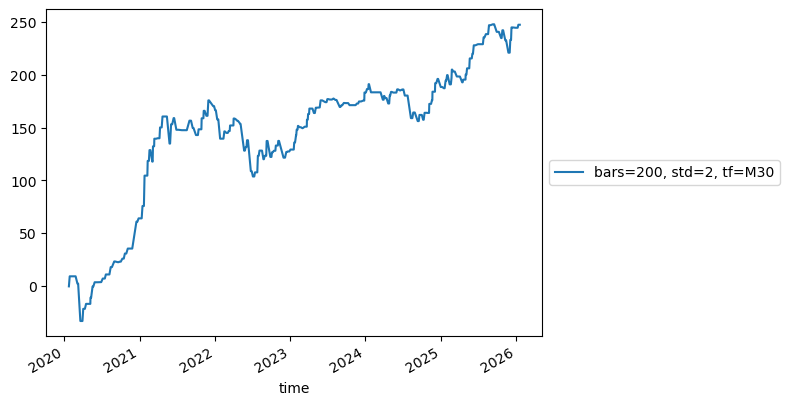

In [5]:
positive_return = 0
negative_return = 0
neutral_return = 0
cutoff = 50 


bars_windows = [200]
stds = [2]
timeframes = ['M30']

for bars in bars_windows:
    for std in stds:
        for tf in timeframes:
            df_trades, return_perc = boll_bands('ETHUSD', bars, std, tf, 100, '2020-01-20')

            if return_perc > cutoff:                                                                                         #counts how many operations were positive, negative or neutral depending on a arbitrary cutoff
                positive_return+= 1
            elif return_perc < (cutoff - 50):
                negative_return+= 1
            else:
                neutral_return+= 1

print(f"positives: {positive_return}, negatives: {negative_return}, neutral: {neutral_return}")

plt.legend(loc='center left', bbox_to_anchor=(1,0.5))                                                                        #no labels over the graph
plt.show()